Imports

In [ ]:
import numpy as np
import pandas as pd
import random

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.ensemble import RandomForestRegressor
from skforecast.recursive._forecaster_recursive_multiseries import ForecasterRecursiveMultiSeries
from sklearn.preprocessing import StandardScaler


Load datasets

In [93]:
train = pd.read_csv('../data/train.csv')
test = pd.read_csv('../data/test.csv')

In [94]:
train.head()

,id,date,country,store,product,num_sold
0,0,2010-01-01,Canada,Discount Stickers,Holographic Goose,NaN
1,1,2010-01-01,Canada,Discount Stickers,Kaggle,973.0
2,2,2010-01-01,Canada,Discount Stickers,Kaggle Tiers,906.0
3,3,2010-01-01,Canada,Discount Stickers,Kerneler,423.0
4,4,2010-01-01,Canada,Discount Stickers,Kerneler Dark Mode,491.0


In [95]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 230130 entries, 0 to 230129
Data columns (total 6 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   id        230130 non-null  int64  
 1   date      230130 non-null  object 
 2   country   230130 non-null  object 
 3   store     230130 non-null  object 
 4   product   230130 non-null  object 
 5   num_sold  221259 non-null  float64
dtypes: float64(1), int64(1), object(4)
memory usage: 10.5+ MB


In [96]:
train['country'].unique()

array(['Canada', 'Finland', 'Italy', 'Kenya', 'Norway', 'Singapore'],
      dtype=object)

In [97]:
train['store'].unique()

array(['Discount Stickers', 'Stickers for Less', 'Premium Sticker Mart'],
      dtype=object)

In [98]:
train['product'].unique()

array(['Holographic Goose', 'Kaggle', 'Kaggle Tiers', 'Kerneler',
       'Kerneler Dark Mode'], dtype=object)

data preparation

set time index

In [99]:
train['date'] = pd.to_datetime(train['date'], format='%Y-%m-%d')
test['date'] = pd.to_datetime(test['date'], format='%Y-%m-%d')

graphic analysis

In [9]:
def plot_individual_ts(df):
    colour_map = {"Canada": "blue", "Finland": "orange", "Italy": "green", "Kenya":"red", "Norway": "purple", "Singapore": "brown"}
    for country in df["country"].unique():
        f,axes = plt.subplots(df["store"].nunique()*df["product"].nunique(),figsize=(20,75))
        count = 0
        for store in df["store"].unique():
            for product in df["product"].unique():
                plot_df = df.loc[(df["product"] == product) & (df["country"] == country) & (df["store"] == store)]
                sns.lineplot(data = plot_df, x= "date", y="num_sold", linewidth=0.5, ax=axes[count], color=colour_map[country])
                axes[count].set_title(f"{country} - {store} - {product}")
                axes[count].axvline(pd.to_datetime("2017-01-01"), color='black', linestyle='--');
                count+=1

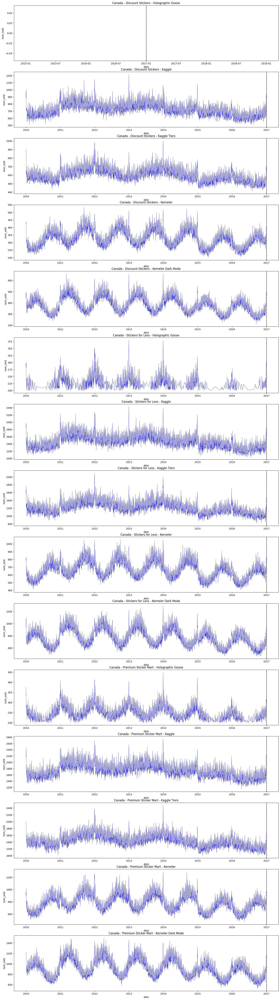

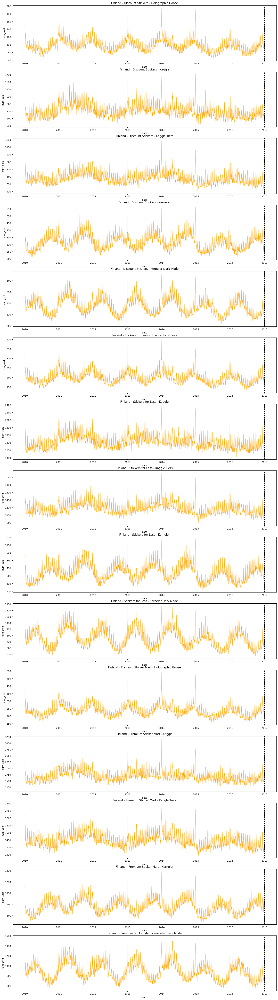

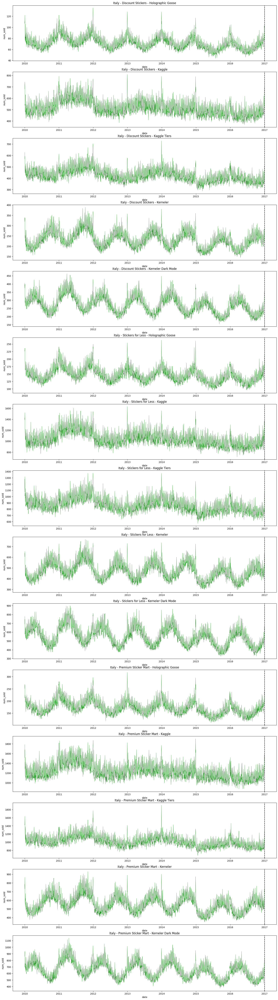

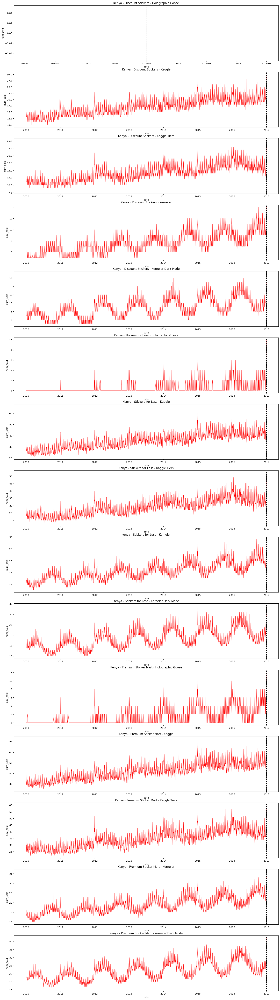

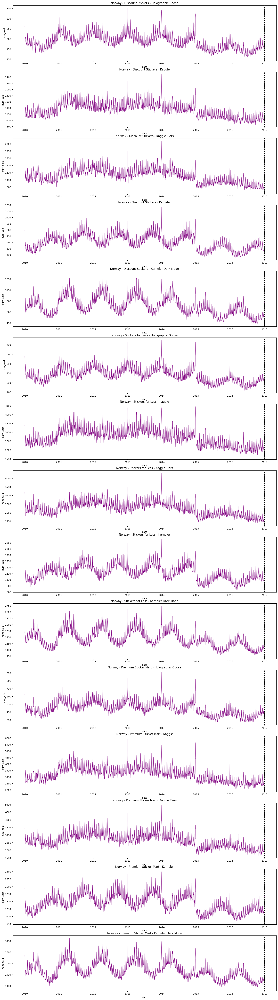

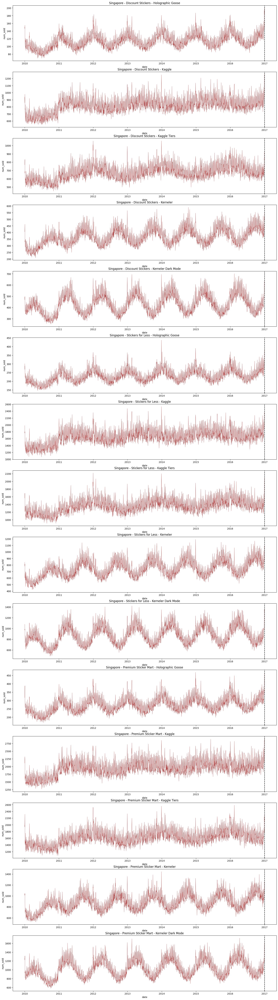

In [17]:
plot_individual_ts(train)

the date is made the index as is a prerrequisite of sklearn

In [100]:
train =train.set_index('date')
test = test.set_index('date')

grouped by country, store and product and generate a dictionary containing individual dataframes, this dataframes will be grouped together to generate multiseries datasets for each product while being used individually to do the predictions. Train and test dataframes corresponding to the same set of conditions will be stored under the same key.

In [101]:
#Grouping
grouped_train = train.groupby(['country', 'store', 'product'])
grouped_test = test.groupby(['country', 'store', 'product'])

In [102]:
#Combine in a dict
combine_dict = {
        key: [group1, grouped_test.get_group(key)]
        for key, group1 in grouped_train
        if key in grouped_test.groups 
    }

Now that the index is a single continuous series of dates, we can check the integrity

In [22]:
for key in combine_dict.keys():
    combine_dict[key][0] = combine_dict[key][0].asfreq('D')
    combine_dict[key][0] = combine_dict[key][0].sort_index()
    combine_dict[key][1] = combine_dict[key][1].asfreq('D')
    combine_dict[key][1] = combine_dict[key][1].sort_index()

There are N/A for the number of stickers sold in some of the datasets, as sklearn doesn't accept N/A, they will be filled with the average of the previous and following values

In [23]:
#create a function that fills the NA
def fill_with_mean_neighbor(series):
    for i in range(len(series)):
        if pd.isna(series.iloc[i]):  # Verify whether it is NaN
            # Get previous and following value
            prev_val = series.iloc[i - 1] if i > 0 else np.nan
            next_val = series.iloc[i + 1] if i < len(series) - 1 else np.nan
            # Calculate average
            neighbors = [val for val in [prev_val, next_val] if not pd.isna(val)]
            series.iloc[i] = np.mean(neighbors) if neighbors else np.nan
    return series

In [24]:
#loop through the dictionary to isolate the series with N/A
for lst in combine_dict.values():
        for group in lst:
            if group.isnull().any(axis=1).sum() == len(group):
                group.fillna(0, inplace=True)
            elif group.isnull().any(axis=1).sum() > 0:
                group.apply(fill_with_mean_neighbor)

Now that the dataframe is clean, it will be organized by products in a dictionary, such that each key (product) will contain a dataframe arranged in a way that sklearn ForecasterRecursiveMultiSeries can be used. In this manner, we create a predictive model for each product using the combination of several time series corresponding to different shops and countries where the product is sold.

First, a lis of the different products is built

In [25]:
products_list = list(train['product'].unique())
products_list

['Holographic Goose',
 'Kaggle',
 'Kaggle Tiers',
 'Kerneler',
 'Kerneler Dark Mode']

Then, the train dataframes are isolated from the test in the combined dictionary

In [26]:
train_df_dic = {key:value[0] for key,value in combine_dict.items()}

There are several columns that are not usable because they contain only zero values in the 'num_sold' column, which need to be removed.

In [27]:
y_column = 'num_sold'

In [28]:
clean_df_dic = dict()
for key, dataset in train_df_dic.items():
    if dataset[y_column].sum() != 0:
        clean_df_dic[key] = dataset

Now, the dataframes need to reconstructed so every different condition (that is, combination of country, shop and product) is set as a column of the dataframe. This is the format needed to use ForecasterRecursiveMultiSeries. With this purpose, the following function is defined:

In [29]:
def group_df(grouped_dic):
    reorg_df = pd.DataFrame({'_'.join(key):df[y_column] for key, df in grouped_dic.items()}) 
    return reorg_df

In [30]:
clean_arranged_df = group_df(clean_df_dic)

In [31]:
clean_arranged_df.head()

,Canada_Discount Stickers_Kaggle,Canada_Discount Stickers_Kaggle Tiers,Canada_Discount Stickers_Kerneler,Canada_Discount Stickers_Kerneler Dark Mode,Canada_Premium Sticker Mart_Holographic Goose,Canada_Premium Sticker Mart_Kaggle,Canada_Premium Sticker Mart_Kaggle Tiers,Canada_Premium Sticker Mart_Kerneler,Canada_Premium Sticker Mart_Kerneler Dark Mode,Canada_Stickers for Less_Holographic Goose,...,Singapore_Premium Sticker Mart_Holographic Goose,Singapore_Premium Sticker Mart_Kaggle,Singapore_Premium Sticker Mart_Kaggle Tiers,Singapore_Premium Sticker Mart_Kerneler,Singapore_Premium Sticker Mart_Kerneler Dark Mode,Singapore_Stickers for Less_Holographic Goose,Singapore_Stickers for Less_Kaggle,Singapore_Stickers for Less_Kaggle Tiers,Singapore_Stickers for Less_Kerneler,Singapore_Stickers for Less_Kerneler Dark Mode
date,,,,,,,,,,,,,,,,,,,,,
2010-01-01,973.0,906.0,423.0,491.0,375.0,2212.0,2013.0,950.0,1213.0,300.0,...,317.0,2112.0,1992.0,1045.0,1255.0,301.0,1981.0,1565.0,841.0,1080.0
2010-01-02,881.0,854.0,440.0,437.0,336.0,2183.0,1953.0,895.0,1217.0,281.0,...,364.0,2322.0,1938.0,1010.0,1224.0,268.0,1763.0,1689.0,781.0,971.0
2010-01-03,1003.0,839.0,417.0,495.0,338.0,2459.0,1938.0,1015.0,1188.0,297.0,...,388.0,2253.0,2315.0,1040.0,1314.0,289.0,1801.0,1690.0,813.0,987.0
2010-01-04,744.0,609.0,339.0,441.0,277.0,1714.0,1567.0,802.0,1046.0,235.0,...,269.0,1760.0,1656.0,846.0,927.0,256.0,1543.0,1205.0,602.0,839.0
2010-01-05,707.0,640.0,290.0,372.0,287.0,1593.0,1590.0,773.0,894.0,240.0,...,264.0,1536.0,1410.0,770.0,962.0,226.0,1364.0,1352.0,629.0,795.0


Next, the columns for each product are isolated and a specific dataframe for each product is constructed and stored again in a dictionary

In [32]:
prod_clean_df_dic = dict()
for prod in products_list:
    prod_df = pd.DataFrame()
    for col in clean_arranged_df.columns:
        if prod in col:
            prod_df = pd.concat([prod_df, clean_arranged_df[col]], axis=1)
            prod_clean_df_dic[prod] = prod_df

In [33]:
display(prod_clean_df_dic['Holographic Goose'].info())

<class 'pandas.core.frame.DataFrame'>
Index: 2557 entries, 2010-01-01 00:00:00 to 2016-12-31 00:00:00
Data columns (total 16 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Canada_Premium Sticker Mart_Holographic Goose     2557 non-null   float64
 1   Canada_Stickers for Less_Holographic Goose        2557 non-null   float64
 2   Finland_Discount Stickers_Holographic Goose       2557 non-null   float64
 3   Finland_Premium Sticker Mart_Holographic Goose    2557 non-null   float64
 4   Finland_Stickers for Less_Holographic Goose       2557 non-null   float64
 5   Italy_Discount Stickers_Holographic Goose         2557 non-null   float64
 6   Italy_Premium Sticker Mart_Holographic Goose      2557 non-null   float64
 7   Italy_Stickers for Less_Holographic Goose         2557 non-null   float64
 8   Kenya_Premium Sticker Mart_Holographic Goose      2557 non-null   floa

None

The dataframes are ready for analysis. Two functions are constructed to create the model and the predictions using ForecasterRecursiveMultiSeries

In [63]:
def create_fit_multi_forecaster(steps, df):
    forecaster = ForecasterRecursiveMultiSeries(
                regressor          = RandomForestRegressor(random_state=123),
                lags               = steps,
                transformer_series = StandardScaler(),
                transformer_exog   = None,
                weight_func        = None,
                series_weights     = None
            )
    
    forecaster.fit(series=df)
    return forecaster

def predict_multi(steps, forecaster, level):
    prediction_level = forecaster.predict(steps=steps, levels=level)
    return prediction_level     

Finally, each product is analysed sequentially

The steps are the lenght of the test dataframe for each product

In [35]:
dic_sample = random.choice(list(combine_dict.values()))
train_sample, test_sample = dic_sample[0], dic_sample[1]
steps = len(test_sample)
steps

1095

In [ ]:
# running these cell may take several days

#The results are stored in a dataframe
submission = pd.DataFrame()
counter = 0
for prod in products_list:
    print(prod)
    #The dataframe with information for each product is isolated
    prod_dataset = prod_clean_df_dic[prod]
    forecaster = create_fit_multi_forecaster(steps, prod_dataset)

    #A loop is set through all the different individualized products
    for key, value in combine_dict.items():
        level_str = '_'.join(key)
        print(level_str)

        #If the product for wich we are looping is detected, predictions are made
        if prod in level_str.split('_'):
            counter += 1
            print(counter)
            print(key)
            if level_str in prod_dataset.columns:
                predictions = predict_multi(steps, forecaster, level_str)
                predictions.index = value[1].index
                #Predictions are added as a column to the test set for each product
                test_w_preds = pd.concat([value[1], predictions], axis=1).rename(columns={f'{level_str}':'num_sold'})
            #If the individualized product is not in the dataset, that means it was removed for being all zeroes, hence the predictions are set to zeroes as well
            else:
                value[1]['num_sold'] = 0
                test_w_preds = value[1]
            #All the predictions are concatenated and distinguished by its unique id
            submission = pd.concat([submission, test_w_preds])
            display(submission)
            submission = submission.reset_index()[['id', 'num_sold']].sort_values('id')
            print(f'submission_updated for {key}')
submission.to_csv('sklearn_example.csv', index=False)
print('submission_saved')

Holographic Goose


c:\Users\josin\anaconda3\envs\skforecast_env\Lib\site-packages\skforecast\utils\utils.py:1167: UserWarning: Series has no DatetimeIndex nor RangeIndex index. Index is overwritten with a RangeIndex.
  warnings.warn(


Canada_Discount Stickers_Holographic Goose
1
('Canada', 'Discount Stickers', 'Holographic Goose')


,id,country,store,product,num_sold
date,,,,,
2017-01-01,230130,Canada,Discount Stickers,Holographic Goose,0
2017-01-02,230220,Canada,Discount Stickers,Holographic Goose,0
2017-01-03,230310,Canada,Discount Stickers,Holographic Goose,0
2017-01-04,230400,Canada,Discount Stickers,Holographic Goose,0
2017-01-05,230490,Canada,Discount Stickers,Holographic Goose,0
...,...,...,...,...,...
2019-12-27,328230,Canada,Discount Stickers,Holographic Goose,0
2019-12-28,328320,Canada,Discount Stickers,Holographic Goose,0
2019-12-29,328410,Canada,Discount Stickers,Holographic Goose,0


submission_updated for ('Canada', 'Discount Stickers', 'Holographic Goose') multi
Canada_Discount Stickers_Kaggle
Canada_Discount Stickers_Kaggle Tiers
Canada_Discount Stickers_Kerneler
Canada_Discount Stickers_Kerneler Dark Mode
Canada_Premium Sticker Mart_Holographic Goose
2
('Canada', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230220,0.000000,NaN,NaN,NaN
2,230310,0.000000,NaN,NaN,NaN
3,230400,0.000000,NaN,NaN,NaN
4,230490,0.000000,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328240,246.088536,Canada,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328330,258.251005,Canada,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328420,268.365036,Canada,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328510,237.567602,Canada,Premium Sticker Mart,Holographic Goose


submission_updated for ('Canada', 'Premium Sticker Mart', 'Holographic Goose') multi
Canada_Premium Sticker Mart_Kaggle
Canada_Premium Sticker Mart_Kaggle Tiers
Canada_Premium Sticker Mart_Kerneler
Canada_Premium Sticker Mart_Kerneler Dark Mode
Canada_Stickers for Less_Holographic Goose
3
('Canada', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1095,230140,282.331232,NaN,NaN,NaN
1,230220,0.000000,NaN,NaN,NaN
1096,230230,243.717075,NaN,NaN,NaN
2,230310,0.000000,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328235,234.248236,Canada,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328325,236.180719,Canada,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328415,247.129703,Canada,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328505,234.801929,Canada,Stickers for Less,Holographic Goose


submission_updated for ('Canada', 'Stickers for Less', 'Holographic Goose') multi
Canada_Stickers for Less_Kaggle
Canada_Stickers for Less_Kaggle Tiers
Canada_Stickers for Less_Kerneler
Canada_Stickers for Less_Kerneler Dark Mode
Finland_Discount Stickers_Holographic Goose
4
('Finland', 'Discount Stickers', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
2190,230135,288.498055,NaN,NaN,NaN
1,230140,282.331232,NaN,NaN,NaN
2,230220,0.000000,NaN,NaN,NaN
2191,230225,229.996470,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328245,116.954050,Finland,Discount Stickers,Holographic Goose
2019-12-28 00:00:00,328335,123.540629,Finland,Discount Stickers,Holographic Goose
2019-12-29 00:00:00,328425,135.295119,Finland,Discount Stickers,Holographic Goose
2019-12-30 00:00:00,328515,105.899407,Finland,Discount Stickers,Holographic Goose


submission_updated for ('Finland', 'Discount Stickers', 'Holographic Goose') multi
Finland_Discount Stickers_Kaggle
Finland_Discount Stickers_Kaggle Tiers
Finland_Discount Stickers_Kerneler
Finland_Discount Stickers_Kerneler Dark Mode
Finland_Premium Sticker Mart_Holographic Goose
5
('Finland', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3285,230145,145.736904,NaN,NaN,NaN
3,230220,0.000000,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328255,281.549526,Finland,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328345,296.822173,Finland,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328435,326.854703,Finland,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328525,254.353913,Finland,Premium Sticker Mart,Holographic Goose


submission_updated for ('Finland', 'Premium Sticker Mart', 'Holographic Goose') multi
Finland_Premium Sticker Mart_Kaggle
Finland_Premium Sticker Mart_Kaggle Tiers
Finland_Premium Sticker Mart_Kerneler
Finland_Premium Sticker Mart_Kerneler Dark Mode
Finland_Stickers for Less_Holographic Goose
6
('Finland', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4380,230155,360.490841,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328250,239.670841,Finland,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328340,252.874856,Finland,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328430,276.634421,Finland,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328520,215.905943,Finland,Stickers for Less,Holographic Goose


submission_updated for ('Finland', 'Stickers for Less', 'Holographic Goose') multi
Finland_Stickers for Less_Kaggle
Finland_Stickers for Less_Kaggle Tiers
Finland_Stickers for Less_Kerneler
Finland_Stickers for Less_Kerneler Dark Mode
Italy_Discount Stickers_Holographic Goose
7
('Italy', 'Discount Stickers', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
5475,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328260,80.407855,Italy,Discount Stickers,Holographic Goose
2019-12-28 00:00:00,328350,87.256594,Italy,Discount Stickers,Holographic Goose
2019-12-29 00:00:00,328440,96.104812,Italy,Discount Stickers,Holographic Goose
2019-12-30 00:00:00,328530,76.327540,Italy,Discount Stickers,Holographic Goose


submission_updated for ('Italy', 'Discount Stickers', 'Holographic Goose') multi
Italy_Discount Stickers_Kaggle
Italy_Discount Stickers_Kaggle Tiers
Italy_Discount Stickers_Kerneler
Italy_Discount Stickers_Kerneler Dark Mode
Italy_Premium Sticker Mart_Holographic Goose
8
('Italy', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328270,195.228130,Italy,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328360,208.052289,Italy,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328450,228.330809,Italy,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328540,183.368636,Italy,Premium Sticker Mart,Holographic Goose


submission_updated for ('Italy', 'Premium Sticker Mart', 'Holographic Goose') multi
Italy_Premium Sticker Mart_Kaggle
Italy_Premium Sticker Mart_Kaggle Tiers
Italy_Premium Sticker Mart_Kerneler
Italy_Premium Sticker Mart_Kerneler Dark Mode
Italy_Stickers for Less_Holographic Goose
9
('Italy', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328265,163.305121,Italy,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328355,174.497335,Italy,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328445,193.160810,Italy,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328535,154.118032,Italy,Stickers for Less,Holographic Goose


submission_updated for ('Italy', 'Stickers for Less', 'Holographic Goose') multi
Italy_Stickers for Less_Kaggle
Italy_Stickers for Less_Kaggle Tiers
Italy_Stickers for Less_Kerneler
Italy_Stickers for Less_Kerneler Dark Mode
Kenya_Discount Stickers_Holographic Goose
10
('Kenya', 'Discount Stickers', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328275,0.000000,Kenya,Discount Stickers,Holographic Goose
2019-12-28 00:00:00,328365,0.000000,Kenya,Discount Stickers,Holographic Goose
2019-12-29 00:00:00,328455,0.000000,Kenya,Discount Stickers,Holographic Goose
2019-12-30 00:00:00,328545,0.000000,Kenya,Discount Stickers,Holographic Goose


submission_updated for ('Kenya', 'Discount Stickers', 'Holographic Goose') multi
Kenya_Discount Stickers_Kaggle
Kenya_Discount Stickers_Kaggle Tiers
Kenya_Discount Stickers_Kerneler
Kenya_Discount Stickers_Kerneler Dark Mode
Kenya_Premium Sticker Mart_Holographic Goose
11
('Kenya', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328285,10.199056,Kenya,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328375,10.324226,Kenya,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328465,10.325527,Kenya,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328555,8.507103,Kenya,Premium Sticker Mart,Holographic Goose


submission_updated for ('Kenya', 'Premium Sticker Mart', 'Holographic Goose') multi
Kenya_Premium Sticker Mart_Kaggle
Kenya_Premium Sticker Mart_Kaggle Tiers
Kenya_Premium Sticker Mart_Kerneler
Kenya_Premium Sticker Mart_Kerneler Dark Mode
Kenya_Stickers for Less_Holographic Goose
12
('Kenya', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328280,7.840636,Kenya,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328370,7.910490,Kenya,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328460,7.863371,Kenya,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328550,7.673595,Kenya,Stickers for Less,Holographic Goose


submission_updated for ('Kenya', 'Stickers for Less', 'Holographic Goose') multi
Kenya_Stickers for Less_Kaggle
Kenya_Stickers for Less_Kaggle Tiers
Kenya_Stickers for Less_Kerneler
Kenya_Stickers for Less_Kerneler Dark Mode
Norway_Discount Stickers_Holographic Goose
13
('Norway', 'Discount Stickers', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328290,197.347096,Norway,Discount Stickers,Holographic Goose
2019-12-28 00:00:00,328380,204.746650,Norway,Discount Stickers,Holographic Goose
2019-12-29 00:00:00,328470,211.832107,Norway,Discount Stickers,Holographic Goose
2019-12-30 00:00:00,328560,187.506719,Norway,Discount Stickers,Holographic Goose


submission_updated for ('Norway', 'Discount Stickers', 'Holographic Goose') multi
Norway_Discount Stickers_Kaggle
Norway_Discount Stickers_Kaggle Tiers
Norway_Discount Stickers_Kerneler
Norway_Discount Stickers_Kerneler Dark Mode
Norway_Premium Sticker Mart_Holographic Goose
14
('Norway', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328300,467.996998,Norway,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328390,496.130588,Norway,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328480,506.375564,Norway,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328570,442.391849,Norway,Premium Sticker Mart,Holographic Goose


submission_updated for ('Norway', 'Premium Sticker Mart', 'Holographic Goose') multi
Norway_Premium Sticker Mart_Kaggle
Norway_Premium Sticker Mart_Kaggle Tiers
Norway_Premium Sticker Mart_Kerneler
Norway_Premium Sticker Mart_Kerneler Dark Mode
Norway_Stickers for Less_Holographic Goose
15
('Norway', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328295,400.510676,Norway,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328385,417.816448,Norway,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328475,432.075220,Norway,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328565,381.157117,Norway,Stickers for Less,Holographic Goose


submission_updated for ('Norway', 'Stickers for Less', 'Holographic Goose') multi
Norway_Stickers for Less_Kaggle
Norway_Stickers for Less_Kaggle Tiers
Norway_Stickers for Less_Kerneler
Norway_Stickers for Less_Kerneler Dark Mode
Singapore_Discount Stickers_Holographic Goose
16
('Singapore', 'Discount Stickers', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328305,191.032871,Singapore,Discount Stickers,Holographic Goose
2019-12-28 00:00:00,328395,187.697074,Singapore,Discount Stickers,Holographic Goose
2019-12-29 00:00:00,328485,198.681384,Singapore,Discount Stickers,Holographic Goose
2019-12-30 00:00:00,328575,156.272855,Singapore,Discount Stickers,Holographic Goose


submission_updated for ('Singapore', 'Discount Stickers', 'Holographic Goose') multi
Singapore_Discount Stickers_Kaggle
Singapore_Discount Stickers_Kaggle Tiers
Singapore_Discount Stickers_Kerneler
Singapore_Discount Stickers_Kerneler Dark Mode
Singapore_Premium Sticker Mart_Holographic Goose
17
('Singapore', 'Premium Sticker Mart', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328315,420.847289,Singapore,Premium Sticker Mart,Holographic Goose
2019-12-28 00:00:00,328405,447.947402,Singapore,Premium Sticker Mart,Holographic Goose
2019-12-29 00:00:00,328495,469.156162,Singapore,Premium Sticker Mart,Holographic Goose
2019-12-30 00:00:00,328585,385.916200,Singapore,Premium Sticker Mart,Holographic Goose


submission_updated for ('Singapore', 'Premium Sticker Mart', 'Holographic Goose') multi
Singapore_Premium Sticker Mart_Kaggle
Singapore_Premium Sticker Mart_Kaggle Tiers
Singapore_Premium Sticker Mart_Kerneler
Singapore_Premium Sticker Mart_Kerneler Dark Mode
Singapore_Stickers for Less_Holographic Goose
18
('Singapore', 'Stickers for Less', 'Holographic Goose')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328310,290.683617,Singapore,Stickers for Less,Holographic Goose
2019-12-28 00:00:00,328400,331.594303,Singapore,Stickers for Less,Holographic Goose
2019-12-29 00:00:00,328490,402.139246,Singapore,Stickers for Less,Holographic Goose
2019-12-30 00:00:00,328580,326.417044,Singapore,Stickers for Less,Holographic Goose


submission_updated for ('Singapore', 'Stickers for Less', 'Holographic Goose') multi
Singapore_Stickers for Less_Kaggle
Singapore_Stickers for Less_Kaggle Tiers
Singapore_Stickers for Less_Kerneler
Singapore_Stickers for Less_Kerneler Dark Mode
Kaggle


c:\Users\josin\anaconda3\envs\skforecast_env\Lib\site-packages\skforecast\utils\utils.py:1167: UserWarning: Series has no DatetimeIndex nor RangeIndex index. Index is overwritten with a RangeIndex.
  warnings.warn(


Canada_Discount Stickers_Holographic Goose
Canada_Discount Stickers_Kaggle
19
('Canada', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
4,230150,296.493550,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328231,742.991414,Canada,Discount Stickers,Kaggle
2019-12-28 00:00:00,328321,775.577978,Canada,Discount Stickers,Kaggle
2019-12-29 00:00:00,328411,839.325737,Canada,Discount Stickers,Kaggle
2019-12-30 00:00:00,328501,711.501042,Canada,Discount Stickers,Kaggle


submission_updated for ('Canada', 'Discount Stickers', 'Kaggle') multi
Canada_Discount Stickers_Kaggle Tiers
Canada_Discount Stickers_Kerneler
Canada_Discount Stickers_Kerneler Dark Mode
Canada_Premium Sticker Mart_Holographic Goose
Canada_Premium Sticker Mart_Kaggle
20
('Canada', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
19710,230131,849.546055,NaN,NaN,NaN
1,230135,288.498055,NaN,NaN,NaN
2,230140,282.331232,NaN,NaN,NaN
3,230145,145.736904,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328241,1781.123485,Canada,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328331,1855.032427,Canada,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328421,2012.509177,Canada,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328511,1701.339557,Canada,Premium Sticker Mart,Kaggle


submission_updated for ('Canada', 'Premium Sticker Mart', 'Kaggle') multi
Canada_Premium Sticker Mart_Kaggle Tiers
Canada_Premium Sticker Mart_Kerneler
Canada_Premium Sticker Mart_Kerneler Dark Mode
Canada_Stickers for Less_Holographic Goose
Canada_Stickers for Less_Kaggle
21
('Canada', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230140,282.331232,NaN,NaN,NaN
20805,230141,1995.529808,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328236,1511.233850,Canada,Stickers for Less,Kaggle
2019-12-28 00:00:00,328326,1566.155900,Canada,Stickers for Less,Kaggle
2019-12-29 00:00:00,328416,1705.603341,Canada,Stickers for Less,Kaggle
2019-12-30 00:00:00,328506,1442.129461,Canada,Stickers for Less,Kaggle


submission_updated for ('Canada', 'Stickers for Less', 'Kaggle') multi
Canada_Stickers for Less_Kaggle Tiers
Canada_Stickers for Less_Kerneler
Canada_Stickers for Less_Kerneler Dark Mode
Finland_Discount Stickers_Holographic Goose
Finland_Discount Stickers_Kaggle
22
('Finland', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
21900,230136,1605.034948,NaN,NaN,NaN
3,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328246,793.331365,Finland,Discount Stickers,Kaggle
2019-12-28 00:00:00,328336,825.270945,Finland,Discount Stickers,Kaggle
2019-12-29 00:00:00,328426,887.162250,Finland,Discount Stickers,Kaggle
2019-12-30 00:00:00,328516,750.705978,Finland,Discount Stickers,Kaggle


submission_updated for ('Finland', 'Discount Stickers', 'Kaggle') multi
Finland_Discount Stickers_Kaggle Tiers
Finland_Discount Stickers_Kerneler
Finland_Discount Stickers_Kerneler Dark Mode
Finland_Premium Sticker Mart_Holographic Goose
Finland_Premium Sticker Mart_Kaggle
23
('Finland', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328256,1918.557046,Finland,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328346,1983.018849,Finland,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328436,2169.937210,Finland,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328526,1836.908871,Finland,Premium Sticker Mart,Kaggle


submission_updated for ('Finland', 'Premium Sticker Mart', 'Kaggle') multi
Finland_Premium Sticker Mart_Kaggle Tiers
Finland_Premium Sticker Mart_Kerneler
Finland_Premium Sticker Mart_Kerneler Dark Mode
Finland_Stickers for Less_Holographic Goose
Finland_Stickers for Less_Kaggle
24
('Finland', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328251,1491.692062,Finland,Stickers for Less,Kaggle
2019-12-28 00:00:00,328341,1608.588813,Finland,Stickers for Less,Kaggle
2019-12-29 00:00:00,328431,1724.000838,Finland,Stickers for Less,Kaggle
2019-12-30 00:00:00,328521,1410.139847,Finland,Stickers for Less,Kaggle


submission_updated for ('Finland', 'Stickers for Less', 'Kaggle') multi
Finland_Stickers for Less_Kaggle Tiers
Finland_Stickers for Less_Kerneler
Finland_Stickers for Less_Kerneler Dark Mode
Italy_Discount Stickers_Holographic Goose
Italy_Discount Stickers_Kaggle
25
('Italy', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328261,558.080107,Italy,Discount Stickers,Kaggle
2019-12-28 00:00:00,328351,586.639924,Italy,Discount Stickers,Kaggle
2019-12-29 00:00:00,328441,642.963580,Italy,Discount Stickers,Kaggle
2019-12-30 00:00:00,328531,527.946950,Italy,Discount Stickers,Kaggle


submission_updated for ('Italy', 'Discount Stickers', 'Kaggle') multi
Italy_Discount Stickers_Kaggle Tiers
Italy_Discount Stickers_Kerneler
Italy_Discount Stickers_Kerneler Dark Mode
Italy_Premium Sticker Mart_Holographic Goose
Italy_Premium Sticker Mart_Kaggle
26
('Italy', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328271,1312.320772,Italy,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328361,1372.251787,Italy,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328451,1502.418855,Italy,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328541,1231.358500,Italy,Premium Sticker Mart,Kaggle


submission_updated for ('Italy', 'Premium Sticker Mart', 'Kaggle') multi
Italy_Premium Sticker Mart_Kaggle Tiers
Italy_Premium Sticker Mart_Kerneler
Italy_Premium Sticker Mart_Kerneler Dark Mode
Italy_Stickers for Less_Holographic Goose
Italy_Stickers for Less_Kaggle
27
('Italy', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328266,1115.013901,Italy,Stickers for Less,Kaggle
2019-12-28 00:00:00,328356,1174.130555,Italy,Stickers for Less,Kaggle
2019-12-29 00:00:00,328446,1285.190713,Italy,Stickers for Less,Kaggle
2019-12-30 00:00:00,328536,1033.178562,Italy,Stickers for Less,Kaggle


submission_updated for ('Italy', 'Stickers for Less', 'Kaggle') multi
Italy_Stickers for Less_Kaggle Tiers
Italy_Stickers for Less_Kerneler
Italy_Stickers for Less_Kerneler Dark Mode
Kenya_Discount Stickers_Holographic Goose
Kenya_Discount Stickers_Kaggle
28
('Kenya', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328276,30.868982,Kenya,Discount Stickers,Kaggle
2019-12-28 00:00:00,328366,31.353783,Kenya,Discount Stickers,Kaggle
2019-12-29 00:00:00,328456,31.213894,Kenya,Discount Stickers,Kaggle
2019-12-30 00:00:00,328546,30.030253,Kenya,Discount Stickers,Kaggle


submission_updated for ('Kenya', 'Discount Stickers', 'Kaggle') multi
Kenya_Discount Stickers_Kaggle Tiers
Kenya_Discount Stickers_Kerneler
Kenya_Discount Stickers_Kerneler Dark Mode
Kenya_Premium Sticker Mart_Holographic Goose
Kenya_Premium Sticker Mart_Kaggle
29
('Kenya', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328286,75.029615,Kenya,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328376,75.945816,Kenya,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328466,73.507376,Kenya,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328556,75.422000,Kenya,Premium Sticker Mart,Kaggle


submission_updated for ('Kenya', 'Premium Sticker Mart', 'Kaggle') multi
Kenya_Premium Sticker Mart_Kaggle Tiers
Kenya_Premium Sticker Mart_Kerneler
Kenya_Premium Sticker Mart_Kerneler Dark Mode
Kenya_Stickers for Less_Holographic Goose
Kenya_Stickers for Less_Kaggle
30
('Kenya', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328281,61.596946,Kenya,Stickers for Less,Kaggle
2019-12-28 00:00:00,328371,63.688886,Kenya,Stickers for Less,Kaggle
2019-12-29 00:00:00,328461,62.080490,Kenya,Stickers for Less,Kaggle
2019-12-30 00:00:00,328551,63.465883,Kenya,Stickers for Less,Kaggle


submission_updated for ('Kenya', 'Stickers for Less', 'Kaggle') multi
Kenya_Stickers for Less_Kaggle Tiers
Kenya_Stickers for Less_Kerneler
Kenya_Stickers for Less_Kerneler Dark Mode
Norway_Discount Stickers_Holographic Goose
Norway_Discount Stickers_Kaggle
31
('Norway', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328291,1375.561500,Norway,Discount Stickers,Kaggle
2019-12-28 00:00:00,328381,1408.311033,Norway,Discount Stickers,Kaggle
2019-12-29 00:00:00,328471,1349.008630,Norway,Discount Stickers,Kaggle
2019-12-30 00:00:00,328561,1313.376587,Norway,Discount Stickers,Kaggle


submission_updated for ('Norway', 'Discount Stickers', 'Kaggle') multi
Norway_Discount Stickers_Kaggle Tiers
Norway_Discount Stickers_Kerneler
Norway_Discount Stickers_Kerneler Dark Mode
Norway_Premium Sticker Mart_Holographic Goose
Norway_Premium Sticker Mart_Kaggle
32
('Norway', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328301,3309.434710,Norway,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328391,3472.873719,Norway,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328481,3578.011225,Norway,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328571,3187.744106,Norway,Premium Sticker Mart,Kaggle


submission_updated for ('Norway', 'Premium Sticker Mart', 'Kaggle') multi
Norway_Premium Sticker Mart_Kaggle Tiers
Norway_Premium Sticker Mart_Kerneler
Norway_Premium Sticker Mart_Kerneler Dark Mode
Norway_Stickers for Less_Holographic Goose
Norway_Stickers for Less_Kaggle
33
('Norway', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328296,2807.534575,Norway,Stickers for Less,Kaggle
2019-12-28 00:00:00,328386,2940.352951,Norway,Stickers for Less,Kaggle
2019-12-29 00:00:00,328476,3071.037706,Norway,Stickers for Less,Kaggle
2019-12-30 00:00:00,328566,2678.314600,Norway,Stickers for Less,Kaggle


submission_updated for ('Norway', 'Stickers for Less', 'Kaggle') multi
Norway_Stickers for Less_Kaggle Tiers
Norway_Stickers for Less_Kerneler
Norway_Stickers for Less_Kerneler Dark Mode
Singapore_Discount Stickers_Holographic Goose
Singapore_Discount Stickers_Kaggle
34
('Singapore', 'Discount Stickers', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328306,958.400565,Singapore,Discount Stickers,Kaggle
2019-12-28 00:00:00,328396,1040.218638,Singapore,Discount Stickers,Kaggle
2019-12-29 00:00:00,328486,1149.816815,Singapore,Discount Stickers,Kaggle
2019-12-30 00:00:00,328576,970.036166,Singapore,Discount Stickers,Kaggle


submission_updated for ('Singapore', 'Discount Stickers', 'Kaggle') multi
Singapore_Discount Stickers_Kaggle Tiers
Singapore_Discount Stickers_Kerneler
Singapore_Discount Stickers_Kerneler Dark Mode
Singapore_Premium Sticker Mart_Holographic Goose
Singapore_Premium Sticker Mart_Kaggle
35
('Singapore', 'Premium Sticker Mart', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328316,2320.963699,Singapore,Premium Sticker Mart,Kaggle
2019-12-28 00:00:00,328406,2523.915621,Singapore,Premium Sticker Mart,Kaggle
2019-12-29 00:00:00,328496,2745.145232,Singapore,Premium Sticker Mart,Kaggle
2019-12-30 00:00:00,328586,2300.516468,Singapore,Premium Sticker Mart,Kaggle


submission_updated for ('Singapore', 'Premium Sticker Mart', 'Kaggle') multi
Singapore_Premium Sticker Mart_Kaggle Tiers
Singapore_Premium Sticker Mart_Kerneler
Singapore_Premium Sticker Mart_Kerneler Dark Mode
Singapore_Stickers for Less_Holographic Goose
Singapore_Stickers for Less_Kaggle
36
('Singapore', 'Stickers for Less', 'Kaggle')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328311,1946.860930,Singapore,Stickers for Less,Kaggle
2019-12-28 00:00:00,328401,2114.121084,Singapore,Stickers for Less,Kaggle
2019-12-29 00:00:00,328491,2318.315330,Singapore,Stickers for Less,Kaggle
2019-12-30 00:00:00,328581,1960.955273,Singapore,Stickers for Less,Kaggle


submission_updated for ('Singapore', 'Stickers for Less', 'Kaggle') multi
Singapore_Stickers for Less_Kaggle Tiers
Singapore_Stickers for Less_Kerneler
Singapore_Stickers for Less_Kerneler Dark Mode
Kaggle Tiers


c:\Users\josin\anaconda3\envs\skforecast_env\Lib\site-packages\skforecast\utils\utils.py:1167: UserWarning: Series has no DatetimeIndex nor RangeIndex index. Index is overwritten with a RangeIndex.
  warnings.warn(


Canada_Discount Stickers_Holographic Goose
Canada_Discount Stickers_Kaggle
Canada_Discount Stickers_Kaggle Tiers
37
('Canada', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
4,230140,282.331232,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328232,642.675651,Canada,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328322,652.064127,Canada,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328412,704.045048,Canada,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328502,598.179951,Canada,Discount Stickers,Kaggle Tiers


submission_updated for ('Canada', 'Discount Stickers', 'Kaggle Tiers') multi
Canada_Discount Stickers_Kerneler
Canada_Discount Stickers_Kerneler Dark Mode
Canada_Premium Sticker Mart_Holographic Goose
Canada_Premium Sticker Mart_Kaggle
Canada_Premium Sticker Mart_Kaggle Tiers
38
('Canada', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
39420,230132,606.774081,NaN,NaN,NaN
2,230135,288.498055,NaN,NaN,NaN
3,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328242,1549.643834,Canada,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328332,1559.020106,Canada,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328422,1684.805474,Canada,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328512,1415.246949,Canada,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Canada', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Canada_Premium Sticker Mart_Kerneler
Canada_Premium Sticker Mart_Kerneler Dark Mode
Canada_Stickers for Less_Holographic Goose
Canada_Stickers for Less_Kaggle
Canada_Stickers for Less_Kaggle Tiers
39
('Canada', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328237,1267.931759,Canada,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328327,1300.633065,Canada,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328417,1415.583988,Canada,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328507,1211.862478,Canada,Stickers for Less,Kaggle Tiers


submission_updated for ('Canada', 'Stickers for Less', 'Kaggle Tiers') multi
Canada_Stickers for Less_Kerneler
Canada_Stickers for Less_Kerneler Dark Mode
Finland_Discount Stickers_Holographic Goose
Finland_Discount Stickers_Kaggle
Finland_Discount Stickers_Kaggle Tiers
40
('Finland', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328247,635.986586,Finland,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328337,659.664809,Finland,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328427,704.806201,Finland,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328517,575.182836,Finland,Discount Stickers,Kaggle Tiers


submission_updated for ('Finland', 'Discount Stickers', 'Kaggle Tiers') multi
Finland_Discount Stickers_Kerneler
Finland_Discount Stickers_Kerneler Dark Mode
Finland_Premium Sticker Mart_Holographic Goose
Finland_Premium Sticker Mart_Kaggle
Finland_Premium Sticker Mart_Kaggle Tiers
41
('Finland', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328257,1436.341836,Finland,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328347,1532.185571,Finland,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328437,1651.774370,Finland,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328527,1357.324283,Finland,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Finland', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Finland_Premium Sticker Mart_Kerneler
Finland_Premium Sticker Mart_Kerneler Dark Mode
Finland_Stickers for Less_Holographic Goose
Finland_Stickers for Less_Kaggle
Finland_Stickers for Less_Kaggle Tiers
42
('Finland', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328252,1221.361047,Finland,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328342,1312.404457,Finland,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328432,1407.355781,Finland,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328522,1150.378280,Finland,Stickers for Less,Kaggle Tiers


submission_updated for ('Finland', 'Stickers for Less', 'Kaggle Tiers') multi
Finland_Stickers for Less_Kerneler
Finland_Stickers for Less_Kerneler Dark Mode
Italy_Discount Stickers_Holographic Goose
Italy_Discount Stickers_Kaggle
Italy_Discount Stickers_Kaggle Tiers
43
('Italy', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328262,446.481079,Italy,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328352,472.304446,Italy,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328442,511.546455,Italy,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328532,421.644849,Italy,Discount Stickers,Kaggle Tiers


submission_updated for ('Italy', 'Discount Stickers', 'Kaggle Tiers') multi
Italy_Discount Stickers_Kerneler
Italy_Discount Stickers_Kerneler Dark Mode
Italy_Premium Sticker Mart_Holographic Goose
Italy_Premium Sticker Mart_Kaggle
Italy_Premium Sticker Mart_Kaggle Tiers
44
('Italy', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328272,1096.868385,Italy,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328362,1115.162854,Italy,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328452,1204.800966,Italy,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328542,999.255486,Italy,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Italy', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Italy_Premium Sticker Mart_Kerneler
Italy_Premium Sticker Mart_Kerneler Dark Mode
Italy_Stickers for Less_Holographic Goose
Italy_Stickers for Less_Kaggle
Italy_Stickers for Less_Kaggle Tiers
45
('Italy', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328267,907.680518,Italy,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328357,954.447751,Italy,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328447,1034.152666,Italy,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328537,862.047234,Italy,Stickers for Less,Kaggle Tiers


submission_updated for ('Italy', 'Stickers for Less', 'Kaggle Tiers') multi
Italy_Stickers for Less_Kerneler
Italy_Stickers for Less_Kerneler Dark Mode
Kenya_Discount Stickers_Holographic Goose
Kenya_Discount Stickers_Kaggle
Kenya_Discount Stickers_Kaggle Tiers
46
('Kenya', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328277,25.387048,Kenya,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328367,25.880087,Kenya,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328457,26.234819,Kenya,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328547,26.138287,Kenya,Discount Stickers,Kaggle Tiers


submission_updated for ('Kenya', 'Discount Stickers', 'Kaggle Tiers') multi
Kenya_Discount Stickers_Kerneler
Kenya_Discount Stickers_Kerneler Dark Mode
Kenya_Premium Sticker Mart_Holographic Goose
Kenya_Premium Sticker Mart_Kaggle
Kenya_Premium Sticker Mart_Kaggle Tiers
47
('Kenya', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328287,58.342824,Kenya,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328377,62.232369,Kenya,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328467,65.081465,Kenya,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328557,65.270216,Kenya,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Kenya', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Kenya_Premium Sticker Mart_Kerneler
Kenya_Premium Sticker Mart_Kerneler Dark Mode
Kenya_Stickers for Less_Holographic Goose
Kenya_Stickers for Less_Kaggle
Kenya_Stickers for Less_Kaggle Tiers
48
('Kenya', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328282,52.926183,Kenya,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328372,52.842699,Kenya,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328462,54.169565,Kenya,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328552,52.068928,Kenya,Stickers for Less,Kaggle Tiers


submission_updated for ('Kenya', 'Stickers for Less', 'Kaggle Tiers') multi
Kenya_Stickers for Less_Kerneler
Kenya_Stickers for Less_Kerneler Dark Mode
Norway_Discount Stickers_Holographic Goose
Norway_Discount Stickers_Kaggle
Norway_Discount Stickers_Kaggle Tiers
49
('Norway', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328292,1041.659468,Norway,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328382,1046.881282,Norway,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328472,1044.111384,Norway,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328562,1044.395281,Norway,Discount Stickers,Kaggle Tiers


submission_updated for ('Norway', 'Discount Stickers', 'Kaggle Tiers') multi
Norway_Discount Stickers_Kerneler
Norway_Discount Stickers_Kerneler Dark Mode
Norway_Premium Sticker Mart_Holographic Goose
Norway_Premium Sticker Mart_Kaggle
Norway_Premium Sticker Mart_Kaggle Tiers
50
('Norway', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328302,2486.201117,Norway,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328392,2493.012077,Norway,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328482,2497.745926,Norway,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328572,2495.248118,Norway,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Norway', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Norway_Premium Sticker Mart_Kerneler
Norway_Premium Sticker Mart_Kerneler Dark Mode
Norway_Stickers for Less_Holographic Goose
Norway_Stickers for Less_Kaggle
Norway_Stickers for Less_Kaggle Tiers
51
('Norway', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328297,2110.868235,Norway,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328387,2113.867591,Norway,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328477,2106.226737,Norway,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328567,2103.168605,Norway,Stickers for Less,Kaggle Tiers


submission_updated for ('Norway', 'Stickers for Less', 'Kaggle Tiers') multi
Norway_Stickers for Less_Kerneler
Norway_Stickers for Less_Kerneler Dark Mode
Singapore_Discount Stickers_Holographic Goose
Singapore_Discount Stickers_Kaggle
Singapore_Discount Stickers_Kaggle Tiers
52
('Singapore', 'Discount Stickers', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328307,763.569539,Singapore,Discount Stickers,Kaggle Tiers
2019-12-28 00:00:00,328397,807.967971,Singapore,Discount Stickers,Kaggle Tiers
2019-12-29 00:00:00,328487,870.179541,Singapore,Discount Stickers,Kaggle Tiers
2019-12-30 00:00:00,328577,811.846922,Singapore,Discount Stickers,Kaggle Tiers


submission_updated for ('Singapore', 'Discount Stickers', 'Kaggle Tiers') multi
Singapore_Discount Stickers_Kerneler
Singapore_Discount Stickers_Kerneler Dark Mode
Singapore_Premium Sticker Mart_Holographic Goose
Singapore_Premium Sticker Mart_Kaggle
Singapore_Premium Sticker Mart_Kaggle Tiers
53
('Singapore', 'Premium Sticker Mart', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328317,1844.820134,Singapore,Premium Sticker Mart,Kaggle Tiers
2019-12-28 00:00:00,328407,1943.524756,Singapore,Premium Sticker Mart,Kaggle Tiers
2019-12-29 00:00:00,328497,2109.746937,Singapore,Premium Sticker Mart,Kaggle Tiers
2019-12-30 00:00:00,328587,1926.781668,Singapore,Premium Sticker Mart,Kaggle Tiers


submission_updated for ('Singapore', 'Premium Sticker Mart', 'Kaggle Tiers') multi
Singapore_Premium Sticker Mart_Kerneler
Singapore_Premium Sticker Mart_Kerneler Dark Mode
Singapore_Stickers for Less_Holographic Goose
Singapore_Stickers for Less_Kaggle
Singapore_Stickers for Less_Kaggle Tiers
54
('Singapore', 'Stickers for Less', 'Kaggle Tiers')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328312,1536.135735,Singapore,Stickers for Less,Kaggle Tiers
2019-12-28 00:00:00,328402,1612.572550,Singapore,Stickers for Less,Kaggle Tiers
2019-12-29 00:00:00,328492,1797.746629,Singapore,Stickers for Less,Kaggle Tiers
2019-12-30 00:00:00,328582,1682.479081,Singapore,Stickers for Less,Kaggle Tiers


submission_updated for ('Singapore', 'Stickers for Less', 'Kaggle Tiers') multi
Singapore_Stickers for Less_Kerneler
Singapore_Stickers for Less_Kerneler Dark Mode
Kerneler


c:\Users\josin\anaconda3\envs\skforecast_env\Lib\site-packages\skforecast\utils\utils.py:1167: UserWarning: Series has no DatetimeIndex nor RangeIndex index. Index is overwritten with a RangeIndex.
  warnings.warn(


Canada_Discount Stickers_Holographic Goose
Canada_Discount Stickers_Kaggle
Canada_Discount Stickers_Kaggle Tiers
Canada_Discount Stickers_Kerneler
55
('Canada', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
4,230136,1605.034948,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328233,335.164103,Canada,Discount Stickers,Kerneler
2019-12-28 00:00:00,328323,359.505827,Canada,Discount Stickers,Kerneler
2019-12-29 00:00:00,328413,380.973314,Canada,Discount Stickers,Kerneler
2019-12-30 00:00:00,328503,321.358982,Canada,Discount Stickers,Kerneler


submission_updated for ('Canada', 'Discount Stickers', 'Kerneler') multi
Canada_Discount Stickers_Kerneler Dark Mode
Canada_Premium Sticker Mart_Holographic Goose
Canada_Premium Sticker Mart_Kaggle
Canada_Premium Sticker Mart_Kaggle Tiers
Canada_Premium Sticker Mart_Kerneler
56
('Canada', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
59130,230133,365.447738,NaN,NaN,NaN
3,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328243,805.688894,Canada,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328333,864.509305,Canada,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328423,928.374063,Canada,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328513,769.339193,Canada,Premium Sticker Mart,Kerneler


submission_updated for ('Canada', 'Premium Sticker Mart', 'Kerneler') multi
Canada_Premium Sticker Mart_Kerneler Dark Mode
Canada_Stickers for Less_Holographic Goose
Canada_Stickers for Less_Kaggle
Canada_Stickers for Less_Kaggle Tiers
Canada_Stickers for Less_Kerneler
57
('Canada', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328238,680.695211,Canada,Stickers for Less,Kerneler
2019-12-28 00:00:00,328328,724.388268,Canada,Stickers for Less,Kerneler
2019-12-29 00:00:00,328418,775.596173,Canada,Stickers for Less,Kerneler
2019-12-30 00:00:00,328508,650.001854,Canada,Stickers for Less,Kerneler


submission_updated for ('Canada', 'Stickers for Less', 'Kerneler') multi
Canada_Stickers for Less_Kerneler Dark Mode
Finland_Discount Stickers_Holographic Goose
Finland_Discount Stickers_Kaggle
Finland_Discount Stickers_Kaggle Tiers
Finland_Discount Stickers_Kerneler
58
('Finland', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328248,342.660420,Finland,Discount Stickers,Kerneler
2019-12-28 00:00:00,328338,365.762652,Finland,Discount Stickers,Kerneler
2019-12-29 00:00:00,328428,394.059538,Finland,Discount Stickers,Kerneler
2019-12-30 00:00:00,328518,322.537253,Finland,Discount Stickers,Kerneler


submission_updated for ('Finland', 'Discount Stickers', 'Kerneler') multi
Finland_Discount Stickers_Kerneler Dark Mode
Finland_Premium Sticker Mart_Holographic Goose
Finland_Premium Sticker Mart_Kaggle
Finland_Premium Sticker Mart_Kaggle Tiers
Finland_Premium Sticker Mart_Kerneler
59
('Finland', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328258,853.342079,Finland,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328348,925.538870,Finland,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328438,1015.421606,Finland,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328528,782.668963,Finland,Premium Sticker Mart,Kerneler


submission_updated for ('Finland', 'Premium Sticker Mart', 'Kerneler') multi
Finland_Premium Sticker Mart_Kerneler Dark Mode
Finland_Stickers for Less_Holographic Goose
Finland_Stickers for Less_Kaggle
Finland_Stickers for Less_Kaggle Tiers
Finland_Stickers for Less_Kerneler
60
('Finland', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328253,689.607558,Finland,Stickers for Less,Kerneler
2019-12-28 00:00:00,328343,730.840007,Finland,Stickers for Less,Kerneler
2019-12-29 00:00:00,328433,791.763382,Finland,Stickers for Less,Kerneler
2019-12-30 00:00:00,328523,647.560936,Finland,Stickers for Less,Kerneler


submission_updated for ('Finland', 'Stickers for Less', 'Kerneler') multi
Finland_Stickers for Less_Kerneler Dark Mode
Italy_Discount Stickers_Holographic Goose
Italy_Discount Stickers_Kaggle
Italy_Discount Stickers_Kaggle Tiers
Italy_Discount Stickers_Kerneler
61
('Italy', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328263,245.708551,Italy,Discount Stickers,Kerneler
2019-12-28 00:00:00,328353,262.565132,Italy,Discount Stickers,Kerneler
2019-12-29 00:00:00,328443,282.512671,Italy,Discount Stickers,Kerneler
2019-12-30 00:00:00,328533,232.537220,Italy,Discount Stickers,Kerneler


submission_updated for ('Italy', 'Discount Stickers', 'Kerneler') multi
Italy_Discount Stickers_Kerneler Dark Mode
Italy_Premium Sticker Mart_Holographic Goose
Italy_Premium Sticker Mart_Kaggle
Italy_Premium Sticker Mart_Kaggle Tiers
Italy_Premium Sticker Mart_Kerneler
62
('Italy', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328273,592.455543,Italy,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328363,629.739300,Italy,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328453,673.752207,Italy,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328543,556.986420,Italy,Premium Sticker Mart,Kerneler


submission_updated for ('Italy', 'Premium Sticker Mart', 'Kerneler') multi
Italy_Premium Sticker Mart_Kerneler Dark Mode
Italy_Stickers for Less_Holographic Goose
Italy_Stickers for Less_Kaggle
Italy_Stickers for Less_Kaggle Tiers
Italy_Stickers for Less_Kerneler
63
('Italy', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328268,504.077917,Italy,Stickers for Less,Kerneler
2019-12-28 00:00:00,328358,534.516605,Italy,Stickers for Less,Kerneler
2019-12-29 00:00:00,328448,585.498430,Italy,Stickers for Less,Kerneler
2019-12-30 00:00:00,328538,471.313985,Italy,Stickers for Less,Kerneler


submission_updated for ('Italy', 'Stickers for Less', 'Kerneler') multi
Italy_Stickers for Less_Kerneler Dark Mode
Kenya_Discount Stickers_Holographic Goose
Kenya_Discount Stickers_Kaggle
Kenya_Discount Stickers_Kaggle Tiers
Kenya_Discount Stickers_Kerneler
64
('Kenya', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328278,13.489205,Kenya,Discount Stickers,Kerneler
2019-12-28 00:00:00,328368,13.696225,Kenya,Discount Stickers,Kerneler
2019-12-29 00:00:00,328458,13.758741,Kenya,Discount Stickers,Kerneler
2019-12-30 00:00:00,328548,13.590097,Kenya,Discount Stickers,Kerneler


submission_updated for ('Kenya', 'Discount Stickers', 'Kerneler') multi
Kenya_Discount Stickers_Kerneler Dark Mode
Kenya_Premium Sticker Mart_Holographic Goose
Kenya_Premium Sticker Mart_Kaggle
Kenya_Premium Sticker Mart_Kaggle Tiers
Kenya_Premium Sticker Mart_Kerneler
65
('Kenya', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328288,33.070408,Kenya,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328378,33.539978,Kenya,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328468,33.697463,Kenya,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328558,32.873808,Kenya,Premium Sticker Mart,Kerneler


submission_updated for ('Kenya', 'Premium Sticker Mart', 'Kerneler') multi
Kenya_Premium Sticker Mart_Kerneler Dark Mode
Kenya_Stickers for Less_Holographic Goose
Kenya_Stickers for Less_Kaggle
Kenya_Stickers for Less_Kaggle Tiers
Kenya_Stickers for Less_Kerneler
66
('Kenya', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328283,27.863687,Kenya,Stickers for Less,Kerneler
2019-12-28 00:00:00,328373,28.233621,Kenya,Stickers for Less,Kerneler
2019-12-29 00:00:00,328463,28.312292,Kenya,Stickers for Less,Kerneler
2019-12-30 00:00:00,328553,27.676082,Kenya,Stickers for Less,Kerneler


submission_updated for ('Kenya', 'Stickers for Less', 'Kerneler') multi
Kenya_Stickers for Less_Kerneler Dark Mode
Norway_Discount Stickers_Holographic Goose
Norway_Discount Stickers_Kaggle
Norway_Discount Stickers_Kaggle Tiers
Norway_Discount Stickers_Kerneler
67
('Norway', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328293,598.152446,Norway,Discount Stickers,Kerneler
2019-12-28 00:00:00,328383,604.750965,Norway,Discount Stickers,Kerneler
2019-12-29 00:00:00,328473,632.441940,Norway,Discount Stickers,Kerneler
2019-12-30 00:00:00,328563,562.428926,Norway,Discount Stickers,Kerneler


submission_updated for ('Norway', 'Discount Stickers', 'Kerneler') multi
Norway_Discount Stickers_Kerneler Dark Mode
Norway_Premium Sticker Mart_Holographic Goose
Norway_Premium Sticker Mart_Kaggle
Norway_Premium Sticker Mart_Kaggle Tiers
Norway_Premium Sticker Mart_Kerneler
68
('Norway', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328303,1440.728337,Norway,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328393,1447.469866,Norway,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328483,1507.809389,Norway,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328573,1338.989113,Norway,Premium Sticker Mart,Kerneler


submission_updated for ('Norway', 'Premium Sticker Mart', 'Kerneler') multi
Norway_Premium Sticker Mart_Kerneler Dark Mode
Norway_Stickers for Less_Holographic Goose
Norway_Stickers for Less_Kaggle
Norway_Stickers for Less_Kaggle Tiers
Norway_Stickers for Less_Kerneler
69
('Norway', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328298,1212.060166,Norway,Stickers for Less,Kerneler
2019-12-28 00:00:00,328388,1223.008416,Norway,Stickers for Less,Kerneler
2019-12-29 00:00:00,328478,1283.959155,Norway,Stickers for Less,Kerneler
2019-12-30 00:00:00,328568,1129.629160,Norway,Stickers for Less,Kerneler


submission_updated for ('Norway', 'Stickers for Less', 'Kerneler') multi
Norway_Stickers for Less_Kerneler Dark Mode
Singapore_Discount Stickers_Holographic Goose
Singapore_Discount Stickers_Kaggle
Singapore_Discount Stickers_Kaggle Tiers
Singapore_Discount Stickers_Kerneler
70
('Singapore', 'Discount Stickers', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328308,420.240527,Singapore,Discount Stickers,Kerneler
2019-12-28 00:00:00,328398,449.925166,Singapore,Discount Stickers,Kerneler
2019-12-29 00:00:00,328488,493.147981,Singapore,Discount Stickers,Kerneler
2019-12-30 00:00:00,328578,394.197507,Singapore,Discount Stickers,Kerneler


submission_updated for ('Singapore', 'Discount Stickers', 'Kerneler') multi
Singapore_Discount Stickers_Kerneler Dark Mode
Singapore_Premium Sticker Mart_Holographic Goose
Singapore_Premium Sticker Mart_Kaggle
Singapore_Premium Sticker Mart_Kaggle Tiers
Singapore_Premium Sticker Mart_Kerneler
71
('Singapore', 'Premium Sticker Mart', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328318,1009.344152,Singapore,Premium Sticker Mart,Kerneler
2019-12-28 00:00:00,328408,1077.007514,Singapore,Premium Sticker Mart,Kerneler
2019-12-29 00:00:00,328498,1155.638007,Singapore,Premium Sticker Mart,Kerneler
2019-12-30 00:00:00,328588,910.668281,Singapore,Premium Sticker Mart,Kerneler


submission_updated for ('Singapore', 'Premium Sticker Mart', 'Kerneler') multi
Singapore_Premium Sticker Mart_Kerneler Dark Mode
Singapore_Stickers for Less_Holographic Goose
Singapore_Stickers for Less_Kaggle
Singapore_Stickers for Less_Kaggle Tiers
Singapore_Stickers for Less_Kerneler
72
('Singapore', 'Stickers for Less', 'Kerneler')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328313,889.628830,Singapore,Stickers for Less,Kerneler
2019-12-28 00:00:00,328403,946.458819,Singapore,Stickers for Less,Kerneler
2019-12-29 00:00:00,328493,1029.329584,Singapore,Stickers for Less,Kerneler
2019-12-30 00:00:00,328583,862.980245,Singapore,Stickers for Less,Kerneler


submission_updated for ('Singapore', 'Stickers for Less', 'Kerneler') multi
Singapore_Stickers for Less_Kerneler Dark Mode
Kerneler Dark Mode


c:\Users\josin\anaconda3\envs\skforecast_env\Lib\site-packages\skforecast\utils\utils.py:1167: UserWarning: Series has no DatetimeIndex nor RangeIndex index. Index is overwritten with a RangeIndex.
  warnings.warn(


Canada_Discount Stickers_Holographic Goose
Canada_Discount Stickers_Kaggle
Canada_Discount Stickers_Kaggle Tiers
Canada_Discount Stickers_Kerneler
Canada_Discount Stickers_Kerneler Dark Mode
73
('Canada', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230135,288.498055,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328234,390.628541,Canada,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328324,406.949999,Canada,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328414,438.743634,Canada,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328504,360.467361,Canada,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Canada', 'Discount Stickers', 'Kerneler Dark Mode') multi
Canada_Premium Sticker Mart_Holographic Goose
Canada_Premium Sticker Mart_Kaggle
Canada_Premium Sticker Mart_Kaggle Tiers
Canada_Premium Sticker Mart_Kerneler
Canada_Premium Sticker Mart_Kerneler Dark Mode
74
('Canada', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
78840,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328244,933.811874,Canada,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328334,973.588482,Canada,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328424,1076.122255,Canada,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328514,855.360265,Canada,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Canada', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Canada_Stickers for Less_Holographic Goose
Canada_Stickers for Less_Kaggle
Canada_Stickers for Less_Kaggle Tiers
Canada_Stickers for Less_Kerneler
Canada_Stickers for Less_Kerneler Dark Mode
75
('Canada', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328239,780.051565,Canada,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328329,817.130493,Canada,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328419,881.367077,Canada,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328509,717.983310,Canada,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Canada', 'Stickers for Less', 'Kerneler Dark Mode') multi
Finland_Discount Stickers_Holographic Goose
Finland_Discount Stickers_Kaggle
Finland_Discount Stickers_Kaggle Tiers
Finland_Discount Stickers_Kerneler
Finland_Discount Stickers_Kerneler Dark Mode
76
('Finland', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328249,377.772103,Finland,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328339,412.397905,Finland,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328429,471.778672,Finland,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328519,375.286328,Finland,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Finland', 'Discount Stickers', 'Kerneler Dark Mode') multi
Finland_Premium Sticker Mart_Holographic Goose
Finland_Premium Sticker Mart_Kaggle
Finland_Premium Sticker Mart_Kaggle Tiers
Finland_Premium Sticker Mart_Kerneler
Finland_Premium Sticker Mart_Kerneler Dark Mode
77
('Finland', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328259,917.719328,Finland,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328349,987.216684,Finland,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328439,1108.851943,Finland,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328529,891.552015,Finland,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Finland', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Finland_Stickers for Less_Holographic Goose
Finland_Stickers for Less_Kaggle
Finland_Stickers for Less_Kaggle Tiers
Finland_Stickers for Less_Kerneler
Finland_Stickers for Less_Kerneler Dark Mode
78
('Finland', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328254,781.305423,Finland,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328344,840.003323,Finland,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328434,949.311607,Finland,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328524,759.624115,Finland,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Finland', 'Stickers for Less', 'Kerneler Dark Mode') multi
Italy_Discount Stickers_Holographic Goose
Italy_Discount Stickers_Kaggle
Italy_Discount Stickers_Kaggle Tiers
Italy_Discount Stickers_Kerneler
Italy_Discount Stickers_Kerneler Dark Mode
79
('Italy', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328264,273.648355,Italy,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328354,291.489883,Italy,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328444,326.305043,Italy,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328534,253.996912,Italy,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Italy', 'Discount Stickers', 'Kerneler Dark Mode') multi
Italy_Premium Sticker Mart_Holographic Goose
Italy_Premium Sticker Mart_Kaggle
Italy_Premium Sticker Mart_Kaggle Tiers
Italy_Premium Sticker Mart_Kerneler
Italy_Premium Sticker Mart_Kerneler Dark Mode
80
('Italy', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328274,649.509970,Italy,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328364,687.819080,Italy,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328454,751.354059,Italy,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328544,595.511071,Italy,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Italy', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Italy_Stickers for Less_Holographic Goose
Italy_Stickers for Less_Kaggle
Italy_Stickers for Less_Kaggle Tiers
Italy_Stickers for Less_Kerneler
Italy_Stickers for Less_Kerneler Dark Mode
81
('Italy', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328269,545.776688,Italy,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328359,582.832037,Italy,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328449,632.534686,Italy,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328539,508.972614,Italy,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Italy', 'Stickers for Less', 'Kerneler Dark Mode') multi
Kenya_Discount Stickers_Holographic Goose
Kenya_Discount Stickers_Kaggle
Kenya_Discount Stickers_Kaggle Tiers
Kenya_Discount Stickers_Kerneler
Kenya_Discount Stickers_Kerneler Dark Mode
82
('Kenya', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328279,14.514942,Kenya,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328369,14.676490,Kenya,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328459,14.886846,Kenya,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328549,14.695724,Kenya,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Kenya', 'Discount Stickers', 'Kerneler Dark Mode') multi
Kenya_Premium Sticker Mart_Holographic Goose
Kenya_Premium Sticker Mart_Kaggle
Kenya_Premium Sticker Mart_Kaggle Tiers
Kenya_Premium Sticker Mart_Kerneler
Kenya_Premium Sticker Mart_Kerneler Dark Mode
83
('Kenya', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328289,35.870001,Kenya,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328379,35.515767,Kenya,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328469,36.346740,Kenya,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328559,35.635732,Kenya,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Kenya', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Kenya_Stickers for Less_Holographic Goose
Kenya_Stickers for Less_Kaggle
Kenya_Stickers for Less_Kaggle Tiers
Kenya_Stickers for Less_Kerneler
Kenya_Stickers for Less_Kerneler Dark Mode
84
('Kenya', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328284,30.095396,Kenya,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328374,30.108740,Kenya,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328464,30.470587,Kenya,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328554,30.225291,Kenya,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Kenya', 'Stickers for Less', 'Kerneler Dark Mode') multi
Norway_Discount Stickers_Holographic Goose
Norway_Discount Stickers_Kaggle
Norway_Discount Stickers_Kaggle Tiers
Norway_Discount Stickers_Kerneler
Norway_Discount Stickers_Kerneler Dark Mode
85
('Norway', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328294,634.728959,Norway,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328384,684.023531,Norway,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328474,733.936827,Norway,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328564,600.364982,Norway,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Norway', 'Discount Stickers', 'Kerneler Dark Mode') multi
Norway_Premium Sticker Mart_Holographic Goose
Norway_Premium Sticker Mart_Kaggle
Norway_Premium Sticker Mart_Kaggle Tiers
Norway_Premium Sticker Mart_Kerneler
Norway_Premium Sticker Mart_Kerneler Dark Mode
86
('Norway', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328304,1568.599685,Norway,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328394,1638.995084,Norway,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328484,1753.990731,Norway,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328574,1421.822477,Norway,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Norway', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Norway_Stickers for Less_Holographic Goose
Norway_Stickers for Less_Kaggle
Norway_Stickers for Less_Kaggle Tiers
Norway_Stickers for Less_Kerneler
Norway_Stickers for Less_Kerneler Dark Mode
87
('Norway', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328299,1271.390452,Norway,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328389,1347.349979,Norway,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328479,1436.023180,Norway,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328569,1218.779873,Norway,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Norway', 'Stickers for Less', 'Kerneler Dark Mode') multi
Singapore_Discount Stickers_Holographic Goose
Singapore_Discount Stickers_Kaggle
Singapore_Discount Stickers_Kaggle Tiers
Singapore_Discount Stickers_Kerneler
Singapore_Discount Stickers_Kerneler Dark Mode
88
('Singapore', 'Discount Stickers', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328309,440.157744,Singapore,Discount Stickers,Kerneler Dark Mode
2019-12-28 00:00:00,328399,476.699771,Singapore,Discount Stickers,Kerneler Dark Mode
2019-12-29 00:00:00,328489,526.134065,Singapore,Discount Stickers,Kerneler Dark Mode
2019-12-30 00:00:00,328579,413.685314,Singapore,Discount Stickers,Kerneler Dark Mode


submission_updated for ('Singapore', 'Discount Stickers', 'Kerneler Dark Mode') multi
Singapore_Premium Sticker Mart_Holographic Goose
Singapore_Premium Sticker Mart_Kaggle
Singapore_Premium Sticker Mart_Kaggle Tiers
Singapore_Premium Sticker Mart_Kerneler
Singapore_Premium Sticker Mart_Kerneler Dark Mode
89
('Singapore', 'Premium Sticker Mart', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328319,1055.419518,Singapore,Premium Sticker Mart,Kerneler Dark Mode
2019-12-28 00:00:00,328409,1138.925550,Singapore,Premium Sticker Mart,Kerneler Dark Mode
2019-12-29 00:00:00,328499,1253.732172,Singapore,Premium Sticker Mart,Kerneler Dark Mode
2019-12-30 00:00:00,328589,999.698347,Singapore,Premium Sticker Mart,Kerneler Dark Mode


submission_updated for ('Singapore', 'Premium Sticker Mart', 'Kerneler Dark Mode') multi
Singapore_Stickers for Less_Holographic Goose
Singapore_Stickers for Less_Kaggle
Singapore_Stickers for Less_Kaggle Tiers
Singapore_Stickers for Less_Kerneler
Singapore_Stickers for Less_Kerneler Dark Mode
90
('Singapore', 'Stickers for Less', 'Kerneler Dark Mode')


,id,num_sold,country,store,product
0,230130,0.000000,NaN,NaN,NaN
1,230131,849.546055,NaN,NaN,NaN
2,230132,606.774081,NaN,NaN,NaN
3,230133,365.447738,NaN,NaN,NaN
4,230134,426.923628,NaN,NaN,NaN
...,...,...,...,...,...
2019-12-27 00:00:00,328314,896.097758,Singapore,Stickers for Less,Kerneler Dark Mode
2019-12-28 00:00:00,328404,974.554781,Singapore,Stickers for Less,Kerneler Dark Mode
2019-12-29 00:00:00,328494,1069.377529,Singapore,Stickers for Less,Kerneler Dark Mode
2019-12-30 00:00:00,328584,858.360042,Singapore,Stickers for Less,Kerneler Dark Mode


submission_updated for ('Singapore', 'Stickers for Less', 'Kerneler Dark Mode') multi
submission_saved


Graphic analysis of the predictions

In [151]:
predictions = pd.read_csv('sklearn_example.csv')
predictions.head()

,id,num_sold
0,230130,0.000000
1,230131,849.546055
2,230132,606.774081
3,230133,365.447738
4,230134,426.923628


In [153]:
train_ri = train.reset_index()
test_ri = test.reset_index()
test_ri.head()

,date,id,country,store,product
0,2017-01-01,230130,Canada,Discount Stickers,Holographic Goose
1,2017-01-01,230131,Canada,Discount Stickers,Kaggle
2,2017-01-01,230132,Canada,Discount Stickers,Kaggle Tiers
3,2017-01-01,230133,Canada,Discount Stickers,Kerneler
4,2017-01-01,230134,Canada,Discount Stickers,Kerneler Dark Mode


submission and test are merged by the unique id of each condition

In [145]:
merged_test = pd.merge(test_ri, submission)

In [146]:
merged_test.head()

,date,id,country,store,product,num_sold
0,2017-01-01,230130,Canada,Discount Stickers,Holographic Goose,0.000000
1,2017-01-01,230131,Canada,Discount Stickers,Kaggle,849.546055
2,2017-01-01,230132,Canada,Discount Stickers,Kaggle Tiers,606.774081
3,2017-01-01,230133,Canada,Discount Stickers,Kerneler,365.447738
4,2017-01-01,230134,Canada,Discount Stickers,Kerneler Dark Mode,426.923628


test data containing the predictions is concatenated to train data

In [154]:
complete_df = pd.concat([train_ri, merged_test]).reset_index(drop=True)
complete_df.head()

,date,id,country,store,product,num_sold
0,2010-01-01,0,Canada,Discount Stickers,Holographic Goose,NaN
1,2010-01-01,1,Canada,Discount Stickers,Kaggle,973.0
2,2010-01-01,2,Canada,Discount Stickers,Kaggle Tiers,906.0
3,2010-01-01,3,Canada,Discount Stickers,Kerneler,423.0
4,2010-01-01,4,Canada,Discount Stickers,Kerneler Dark Mode,491.0


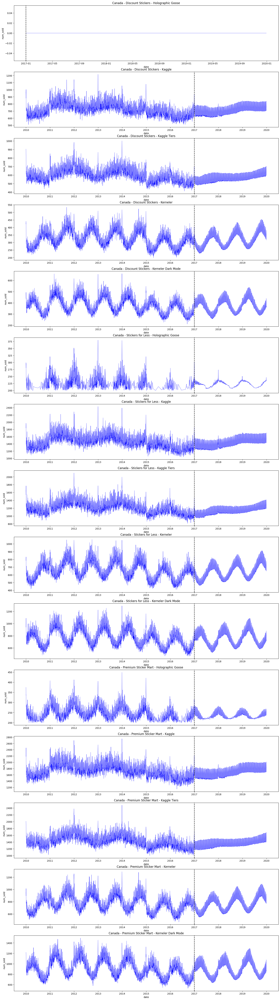

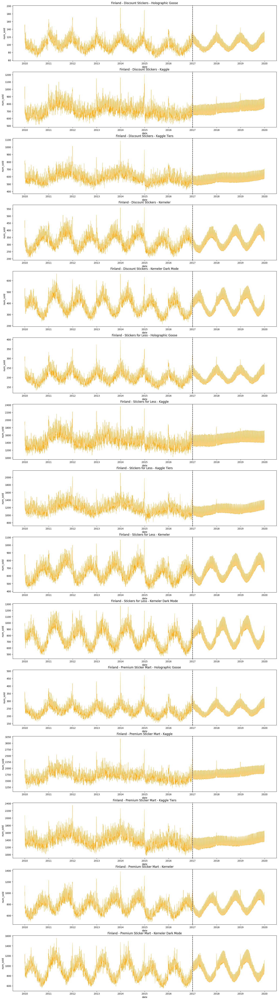

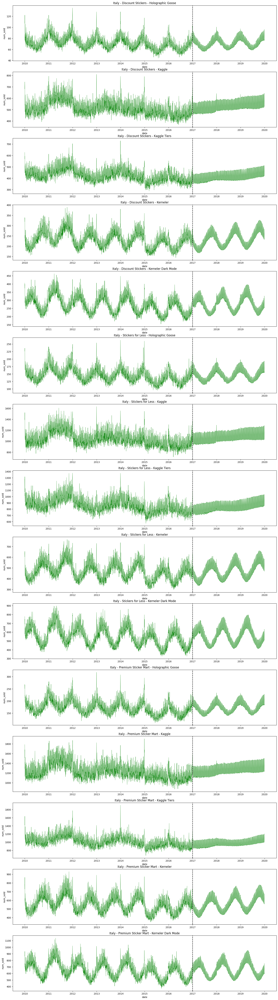

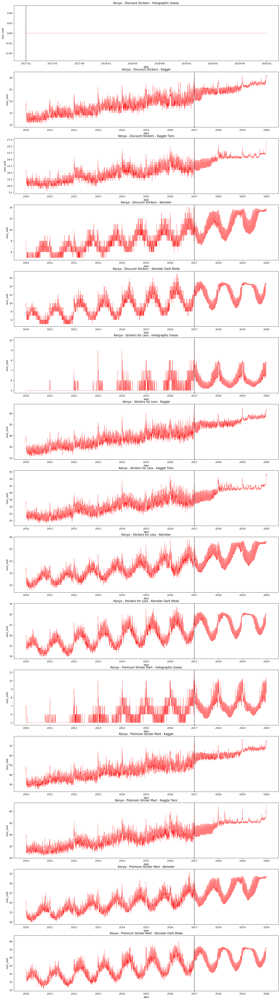

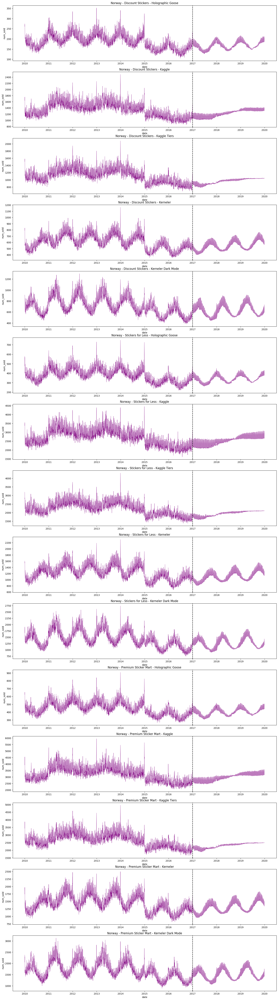

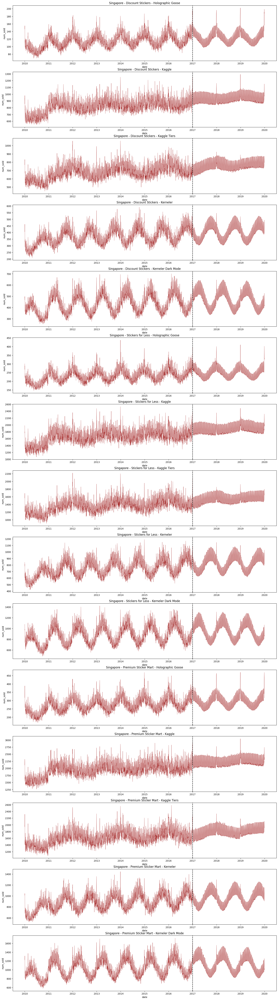

In [150]:
plot_individual_ts(complete_df)